##Installing neccessary python packages for ML/DL models


In [ ]:
!pip install numpy
!pip install pandas
!pip install matplotlib
!pip install scikit-learn
!pip install scikit-optimize
!pip install rasterio
!pip install scipy
!pip install tensorflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.8/107.8 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 42.6 MB/s eta 0:00:00


##Importing neccessary python modules

Importing numpy, pandas, matplotlib and rasterio for data manupilation, data visualization and image visualization

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import ListedColormap
import rasterio

Importing hypertunning tools like Grid Search, Randomized Search and Bayes Search

In [ ]:
from sklearn.metrics import accuracy_score, classification_report,confusion_matrix,f1_score, precision_score, recall_score
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer

Importing Support Vector Machine(SVM) and RandomForest model

In [ ]:
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import uniform,randint

##Importing the Neccessary data from the drive

This Dataset 'data1' is used for train-test-validate the defined ML/DL model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data1 = pd.read_csv('/content/drive/MyDrive/LULC/Satara-FeatureCollection.csv')
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2301 entries, 0 to 2300
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   system:index  2301 non-null   object 
 1   B1            2301 non-null   float64
 2   B11           2301 non-null   float64
 3   B12           2301 non-null   float64
 4   B2            2301 non-null   float64
 5   B3            2301 non-null   float64
 6   B4            2301 non-null   float64
 7   B5            2301 non-null   float64
 8   B6            2301 non-null   float64
 9   B7            2301 non-null   float64
 10  B8            2301 non-null   float64
 11  B8A           2301 non-null   float64
 12  B9            2301 non-null   float64
 13  Class         2301 non-null   object 
 14  .geo          2301 non-null   object 
dtypes: float64(12), object(3)
memory usage: 269.8+ KB


In [ ]:
data1.head()

,Unnamed: 0.1,Unnamed: 0,system:index,B1,B11,B12,B2,B3,B4,B5,B6,B7,B8,B8A,B9,Class,.geo
0,0,0,0_0,0.03025,0.02155,0.01320,0.02085,0.02355,0.01450,0.01745,0.02090,0.02500,0.01925,0.02415,0.10205,Water,"{""type"":""MultiPoint"",""coordinates"":[]}"
1,1,1,1_0,0.03215,0.03555,0.02130,0.02325,0.02510,0.01410,0.01660,0.01780,0.01920,0.01735,0.01955,0.15985,Water,"{""type"":""MultiPoint"",""coordinates"":[]}"
2,2,2,2_0,0.03215,0.02675,0.01490,0.02160,0.02310,0.01415,0.01545,0.01735,0.02125,0.01845,0.02025,0.15985,Water,"{""type"":""MultiPoint"",""coordinates"":[]}"
3,3,3,3_0,0.03170,0.02045,0.01345,0.02420,0.02485,0.01485,0.01765,0.01935,0.02090,0.01850,0.02055,0.09910,Water,"{""type"":""MultiPoint"",""coordinates"":[]}"
4,4,4,4_0,0.03220,0.02255,0.01490,0.02275,0.02520,0.01430,0.01705,0.02040,0.02050,0.01955,0.02180,0.11815,Water,"{""type"":""MultiPoint"",""coordinates"":[]}"


This dataset 'data2' is used to test our defined ML/DL model

In [ ]:
data2 = pd.read_csv('/content/drive/MyDrive/LULC/Goa-FeatureCollection.csv')

In [ ]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 343231 entries, 0 to 343230
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Unnamed: 0.1  343231 non-null  int64  
 1   Unnamed: 0    343231 non-null  int64  
 2   B1            343231 non-null  float64
 3   B11           343231 non-null  float64
 4   B12           343231 non-null  float64
 5   B2            343231 non-null  float64
 6   B3            343231 non-null  float64
 7   B4            343231 non-null  float64
 8   B5            343231 non-null  float64
 9   B6            343231 non-null  float64
 10  B7            343231 non-null  float64
 11  B8            343231 non-null  float64
 12  B8A           343231 non-null  float64
 13  B9            343231 non-null  float64
 14  Class         343231 non-null  object 
dtypes: float64(12), int64(2), object(1)
memory usage: 39.3+ MB


In [ ]:
data2.head()

,Unnamed: 0.1,Unnamed: 0,B1,B11,B12,B2,B3,B4,B5,B6,B7,B8,B8A,B9,Class
0,0,0,0.0549,0.2058,0.1624,0.0746,0.0982,0.1130,0.1352,0.1698,0.1909,0.1730,0.1967,0.2553,BuiltUp
1,1,1,0.0683,0.2136,0.1751,0.1110,0.1378,0.1510,0.1482,0.1825,0.1924,0.2000,0.2080,0.2253,BuiltUp
2,2,2,0.0683,0.2136,0.1751,0.1366,0.1572,0.1718,0.1482,0.1825,0.1924,0.2164,0.2080,0.2253,BuiltUp
3,3,3,0.0683,0.2249,0.1821,0.1200,0.1510,0.1656,0.1543,0.1922,0.1973,0.2130,0.2100,0.2253,BuiltUp
4,4,4,0.0683,0.2249,0.1821,0.1188,0.1452,0.1598,0.1543,0.1922,0.1973,0.2210,0.2100,0.2253,BuiltUp


This two images named 'image1' and 'image2' used and create a LULC classification map using defined ML/DL models

In [ ]:
x_train,x_temp,y_train,y_temp = train_test_split(data1[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data1['Class'],test_size = 0.4,random_state = 42)
x_val,x_test,y_val,y_test = train_test_split(x_temp,y_temp,test_size = 0.5,random_state = 42)

In [ ]:
image1 = rasterio.open('/content/drive/MyDrive/LULC/Delhi.tif')
image2 = rasterio.open('/content/drive/MyDrive/LULC/Gudur.tif')

In [ ]:
image1_shape = image1.read(1).shape
image2_shape = image2.read(1).shape

Defined a function which convert the tiff format image(contain 12 bands) to csv file

In [ ]:
def tiff_to_csv(image):
  bands = ['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']
  data = []
  for i in range(1,image.count+1):
    band = image.read(i)
    data.append(band.flatten())
  data = np.array(data).T
  dataset = pd.DataFrame(data,columns=bands)
  if dataset.isna().any().any():
    dataset.fillna(0.0001,inplace=True)
  return dataset

In [ ]:
image1_dataset = tiff_to_csv(image1)
image1_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150088 entries, 0 to 150087
Data columns (total 12 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   B1      150088 non-null  float64
 1   B2      150088 non-null  float64
 2   B3      150088 non-null  float64
 3   B4      150088 non-null  float64
 4   B5      150088 non-null  float64
 5   B6      150088 non-null  float64
 6   B7      150088 non-null  float64
 7   B8      150088 non-null  float64
 8   B8A     150088 non-null  float64
 9   B9      150088 non-null  float64
 10  B11     150088 non-null  float64
 11  B12     150088 non-null  float64
dtypes: float64(12)
memory usage: 13.7 MB


In [ ]:
image1_dataset.head()

,B1,B2,B3,B4,B5,B6,B7,B8,B8A,B9,B11,B12
0,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
1,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
2,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
3,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
4,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001


In [ ]:
image2_dataset = tiff_to_csv(image2)
image2_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58734 entries, 0 to 58733
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   B1      58734 non-null  float64
 1   B2      58734 non-null  float64
 2   B3      58734 non-null  float64
 3   B4      58734 non-null  float64
 4   B5      58734 non-null  float64
 5   B6      58734 non-null  float64
 6   B7      58734 non-null  float64
 7   B8      58734 non-null  float64
 8   B8A     58734 non-null  float64
 9   B9      58734 non-null  float64
 10  B11     58734 non-null  float64
 11  B12     58734 non-null  float64
dtypes: float64(12)
memory usage: 5.4 MB


In [ ]:
image2_dataset.head()

,B1,B2,B3,B4,B5,B6,B7,B8,B8A,B9,B11,B12
0,0.0344,0.0365,0.0636,0.0386,0.1012,0.2666,0.3016,0.3228,0.3358,0.3111,0.2007,0.0971
1,0.0344,0.0354,0.0580,0.0354,0.1012,0.2666,0.3016,0.3364,0.3358,0.3111,0.2007,0.0971
2,0.0387,0.0352,0.0653,0.0416,0.0935,0.2494,0.2974,0.3476,0.3301,0.3069,0.1891,0.0980
3,0.0387,0.0340,0.0594,0.0438,0.0935,0.2494,0.2974,0.2698,0.3301,0.3069,0.1891,0.0980
4,0.0387,0.0317,0.0498,0.0316,0.0847,0.2225,0.2656,0.2588,0.2983,0.3069,0.1668,0.0808


# Defined the functions which cover the class labels to the classified Map

In [ ]:
pip install earthpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 8.9 MB/s eta 0:00:00


In [ ]:
import earthpy.plot as ep

In [ ]:
def PlotClassifiedMap(image, labels, image_shape, title):
    color_map = {
        'Water': [0.53, 0.81, 0.98],
        'BuiltUp': [1, 0, 0],
        'Vegetation': [0.13, 0.55, 0.13],
        'BarrenLand': [1, 0.65, 0],
        'Agricultural': [1, 1, 0]
    }

    fig, axs = plt.subplots(1, 3, figsize=(20, 7))

    # RGB Image Bands 4, 3, 2
    image_vis_432 = np.stack([image.read(b) for b in [4, 3, 2]])
    ep.plot_rgb(image_vis_432, ax=axs[0], stretch=True)
    axs[0].set_title('Image (Bands 4, 3, 2)')
    axs[0].axis('off')

    # RGB Image Bands 8, 4, 3
    image_vis_843 = np.stack([image.read(b) for b in [8, 4, 3]])
    ep.plot_rgb(image_vis_843, ax=axs[1], stretch=True)
    axs[1].set_title('Image (Bands 8, 4, 3)')
    axs[1].axis('off')

    # Classified land cover map
    # Classified land cover map
    land_cover = labels.reshape(image_shape[0], image_shape[1])
    rgb_array = np.array([[color_map.get(value, [0, 0, 0]) for value in row] for row in land_cover])
    axs[2].imshow(rgb_array, aspect='equal')

    unique, counts = np.unique(land_cover, return_counts=True)
    total_pixels = land_cover.size
    percentages = {label: (count / total_pixels) * 100 for label, count in zip(unique, counts)}

    colors = [color_map[key] for key in color_map]
    labels = [f"{key}: {percentages.get(key, 0):.2f}%" for key in color_map]
    patches = [plt.plot([], [], marker="s", ms=10, ls="", mec=None, color=colors[i],
                        label=labels[i])[0] for i in range(len(labels))]

    # Add the legend with title 'Land Cover Classes'
    axs[2].legend(handles=patches, bbox_to_anchor=(1, 1), loc="upper left", frameon=False, title="Land Cover Classes")
    axs[2].set_title(title)
    axs[2].axis('off')

    # Calculate the percentage of each class
    unique, counts = np.unique(land_cover, return_counts=True)
    total_pixels = land_cover.size
    percentages = {label: (count / total_pixels) * 100 for label, count in zip(unique, counts)}

    # Add a legend with class names, colors, and percentages
    colors = [color_map[key] for key in color_map]
    labels = [f"{key}: {percentages.get(key, 0):.2f}%" for key in color_map]
    patches = [plt.plot([], [], marker="s", ms=10, ls="", mec=None, color=colors[i],
                        label=labels[i])[0] for i in range(len(labels))]
    axs[1].legend(handles=patches, bbox_to_anchor=(1, 1), loc="upper left", frameon=False)

    axs[1].set_title(title)
    axs[1].axis('off')  # Turn off the axis if you don't want to see the ticks

    plt.show()


In [ ]:
def getAccuracyAndClassificationReport(model,x_val,y_val,x_test,y_test):
    # Evaluate on the validation set
    y_val_pred = model.predict(x_val)
    print("Validation Set Evaluation:")
    print("Accuracy: ", accuracy_score(y_val, y_val_pred))
    print("Confusion Matrix:\n", confusion_matrix(y_val, y_val_pred))
    print("Classification Report:\n", classification_report(y_val, y_val_pred))
    print("F1 Score:",f1_score(y_val,y_val_pred,average='weighted'))
    print("Precision:",precision_score(y_val,y_val_pred,average='weighted'))
    print("Recall:",recall_score(y_val,y_val_pred,average='weighted'))

    # Evaluate on the test set
    y_test_pred = model.predict(x_test)
    print("Test Set Evaluation:")
    print("Accuracy: ", accuracy_score(y_test, y_test_pred))
    print("Confusion Matrix:\n", confusion_matrix(y_test, y_test_pred))
    print("Classification Report:\n", classification_report(y_test, y_test_pred))
    print("F1 Score:",f1_score(y_val,y_val_pred,average='weighted'))
    print("Precision:",precision_score(y_val,y_val_pred,average='weighted'))
    print("Recall:",recall_score(y_val,y_val_pred,average='weighted'))

In [ ]:
def getTestAccuracy(model,x_test,y_test):
  y_pred = model.predict(x_test)
  accuracy = accuracy_score(y_test,y_pred)

  print(f"\nAccuracy: {accuracy}\n")
  print(classification_report(y_test,y_pred))

#Support Vector Machine(SVM)

##SVM using Grid search

In [ ]:
param_grid = {
        'C': [0.1, 1, 10, 100],
        'kernel': ['linear', 'rbf'],
        'gamma': [1, 0.1, 0.01, 0.001],
    }

SVM_GS = GridSearchCV(SVC(), param_grid, refit=True, verbose=0, cv=5)
SVM_GS.fit(x_train,y_train)
print(f"Best Parameters: {SVM_GS.best_params_}")
print(f"Best Estimator: {SVM_GS.best_estimator_}")

getAccuracyAndClassificationReport(SVM_GS,x_val,y_val,x_test,y_test)

Best Parameters: {'C': 100, 'gamma': 1, 'kernel': 'rbf'}
Best Estimator: SVC(C=100, gamma=1)
Validation Set Evaluation:
Accuracy:  0.967391304347826
Confusion Matrix:
 [[ 81   7   0   1   0]
 [  5  83   0   0   0]
 [  1   0  98   0   0]
 [  1   0   0 101   0]
 [  0   0   0   0  82]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.92      0.91      0.92        89
  BarrenLand       0.92      0.94      0.93        88
     BuiltUp       1.00      0.99      0.99        99
  Vegetation       0.99      0.99      0.99       102
       Water       1.00      1.00      1.00        82

    accuracy                           0.97       460
   macro avg       0.97      0.97      0.97       460
weighted avg       0.97      0.97      0.97       460

F1 Score: 0.9674402277780765
Precision: 0.967556543697848
Recall: 0.967391304347826
Test Set Evaluation:
Accuracy:  0.9869848156182213
Confusion Matrix:
 [[112   1   0   1   0]
 [  4  88   0   0   0]
 [ 

Testing our model using data2

In [ ]:
getTestAccuracy(SVM_GS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.4766416923754958

              precision    recall  f1-score   support

Agricultural       0.08      0.06      0.07       880
  BarrenLand       0.21      0.51      0.29       705
     BuiltUp       0.77      0.11      0.20      1007
  Vegetation       0.95      0.75      0.84       944
       Water       0.75      0.93      0.83      1002

    accuracy                           0.48      4538
   macro avg       0.55      0.47      0.44      4538
weighted avg       0.58      0.48      0.46      4538



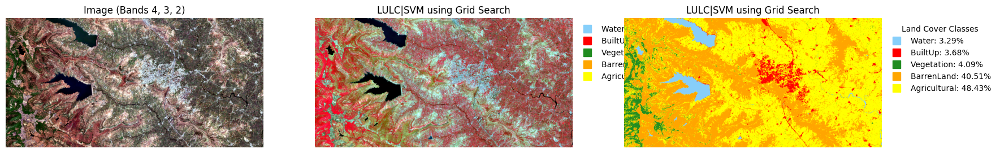

In [ ]:
labels = SVM_GS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|SVM using Grid Search')

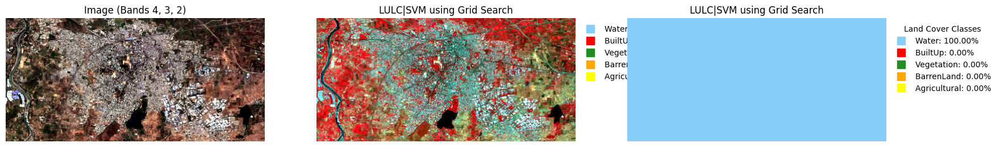

In [ ]:
labels = SVM_GS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|SVM using Grid Search')

In [ ]:
import pickle

# Save the model after Grid Search tuning
with open('SVM-Grid-Search.pkl', 'wb') as file:
    pickle.dump(SVM_GS, file)


In [ ]:
# Load the pre-trained model
with open('SVM-Fine-Tuned-3.pkl', 'rb') as file:
    pre_trained_model_3 = pickle.load(file)


In [ ]:
# New dataset loading
data3 = pd.read_csv('/content/drive/MyDrive/LULC/Goa-2-FeatureCollection.csv')

# Prepare the new training and validation splits from new data
x_train_new, x_temp_new, y_train_new, y_temp_new = train_test_split(
    data3[['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12']],
    data3['Class'],
    test_size=0.4,
    random_state=42
)
x_val_new, x_test_new, y_val_new, y_test_new = train_test_split(x_temp_new, y_temp_new, test_size=0.5, random_state=42)

# Combine old and new training data
x_combined_train = pd.concat([x_train, x_train_new])
y_combined_train = pd.concat([y_train, y_train_new])

# Fine-tuning the loaded model with new and old combined data
pre_trained_model_3.fit(x_combined_train, y_combined_train)

# Evaluate the fine-tuned model on the new validation and test data
getAccuracyAndClassificationReport(pre_trained_model_3, x_val_new, y_val_new, x_test_new, y_test_new)

# Test accuracy for the newly trained model
getTestAccuracy(pre_trained_model_3, x_test_new, y_test_new)


Validation Set Evaluation:
Accuracy:  0.9164490861618799
Confusion Matrix:
 [[ 19  26   0   1   0]
 [  0  93   0   0   0]
 [  2   3  36   0   0]
 [  0   0   0  89   0]
 [  0   0   0   0 114]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.90      0.41      0.57        46
  BarrenLand       0.76      1.00      0.87        93
     BuiltUp       1.00      0.88      0.94        41
  Vegetation       0.99      1.00      0.99        89
       Water       1.00      1.00      1.00       114

    accuracy                           0.92       383
   macro avg       0.93      0.86      0.87       383
weighted avg       0.93      0.92      0.91       383

F1 Score: 0.9070125896241411
Precision: 0.9282600557522442
Recall: 0.9164490861618799
Test Set Evaluation:
Accuracy:  0.9322916666666666
Confusion Matrix:
 [[ 26  17   0   1   0]
 [  1 100   0   0   0]
 [  1   6  32   0   0]
 [  0   0   0 110   0]
 [  0   0   0   0  90]]
Classification Report:


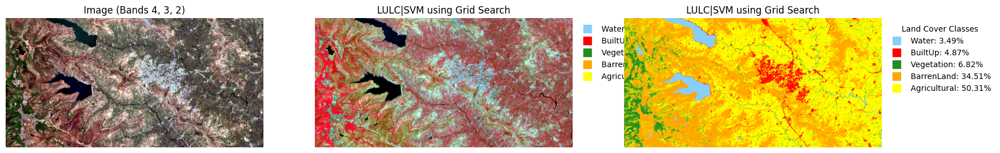

In [ ]:
labels = pre_trained_model_3.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|SVM using Grid Search')

In [ ]:
# Save the fine-tuned model
with open('SVM-Fine-Tuned-3.pkl', 'wb') as file:
    pickle.dump(pre_trained_model_3, file)


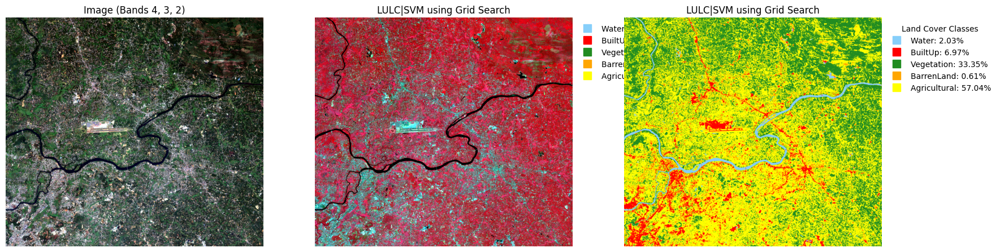

In [ ]:
labels = pre_trained_model_3.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|SVM using Grid Search')

##SVM using Randomized Search

In [ ]:
param_dist = {
      'C': uniform(0.1, 100),  # Uniform distribution between 0.1 and 100
      'gamma': uniform(0.001, 1),  # Uniform distribution between 0.001 and 1
      'kernel': ['linear', 'rbf', 'poly', 'sigmoid']
      }
SVM_RS = RandomizedSearchCV(SVC(),param_distributions=param_dist,n_iter=100,refit=True,verbose=0,cv=5,random_state=42)
SVM_RS.fit(x_train,y_train)
print(f"Best Parameters: {SVM_RS.best_params_}")
print(f"Best Estimator: {SVM_RS.best_estimator_}")
getAccuracyAndClassificationReport(SVM_RS,x_val,y_val,x_test,y_test)

Best Parameters: {'C': 97.05846277645585, 'gamma': 0.7761328233611146, 'kernel': 'rbf'}
Best Estimator: SVC(C=97.05846277645585, gamma=0.7761328233611146)
Validation Set Evaluation:
Accuracy:  0.9630434782608696
Confusion Matrix:
 [[81  7  0  1  0]
 [ 5 83  0  0  0]
 [ 1  0 98  0  0]
 [ 3  0  0 99  0]
 [ 0  0  0  0 82]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.90      0.91      0.91        89
  BarrenLand       0.92      0.94      0.93        88
     BuiltUp       1.00      0.99      0.99        99
  Vegetation       0.99      0.97      0.98       102
       Water       1.00      1.00      1.00        82

    accuracy                           0.96       460
   macro avg       0.96      0.96      0.96       460
weighted avg       0.96      0.96      0.96       460

F1 Score: 0.9632446993752014
Precision: 0.9635555555555557
Recall: 0.9630434782608696
Test Set Evaluation:
Accuracy:  0.9869848156182213
Confusion Matrix:
 [[112   1

In [ ]:
getTestAccuracy(SVM_RS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.46870868223887174

              precision    recall  f1-score   support

Agricultural       0.08      0.06      0.07       880
  BarrenLand       0.20      0.51      0.29       705
     BuiltUp       0.79      0.12      0.21      1007
  Vegetation       0.95      0.71      0.82       944
       Water       0.75      0.92      0.82      1002

    accuracy                           0.47      4538
   macro avg       0.56      0.46      0.44      4538
weighted avg       0.59      0.47      0.46      4538



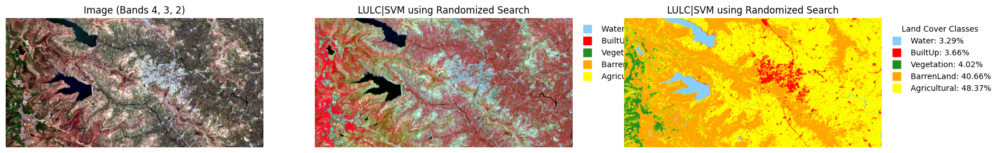

In [ ]:
labels = SVM_RS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|SVM using Randomized Search')

In [ ]:
import pickle

# Save the model after Grid Search tuning
with open('pre_trained_model_2.pkl', 'wb') as file:
    pickle.dump(SVM_RS, file)

In [ ]:

# Load the pre-trained model
with open('pre_trained_model_2.pkl', 'rb') as file:
    pre_trained_model_2 = pickle.load(file)

Validation Set Evaluation:
Accuracy:  0.9801587301587301
Confusion Matrix:
 [[ 93   2   0   2   0]
 [  1 110   2   0   0]
 [  0   1 101   0   0]
 [  0   1   0  84   0]
 [  0   0   1   0 106]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.99      0.96      0.97        97
  BarrenLand       0.96      0.97      0.97       113
     BuiltUp       0.97      0.99      0.98       102
  Vegetation       0.98      0.99      0.98        85
       Water       1.00      0.99      1.00       107

    accuracy                           0.98       504
   macro avg       0.98      0.98      0.98       504
weighted avg       0.98      0.98      0.98       504

F1 Score: 0.9801626854646988
Precision: 0.9803256368002521
Recall: 0.9801587301587301
Test Set Evaluation:
Accuracy:  0.9782178217821782
Confusion Matrix:
 [[ 94   0   0   1   0]
 [  2  90   1   0   0]
 [  1   3 101   0   0]
 [  1   0   0 107   0]
 [  0   1   1   0 102]]
Classification Report:


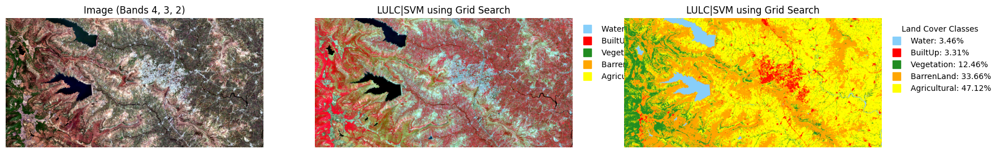

In [ ]:
# New dataset loading
data3 = pd.read_csv('/content/drive/MyDrive/LULC/VijayWada-FeatureCollection.csv')

# Prepare the new training and validation splits from new data
x_train_new, x_temp_new, y_train_new, y_temp_new = train_test_split(
    data3[['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12']],
    data3['Class'],
    test_size=0.4,
    random_state=42
)
x_val_new, x_test_new, y_val_new, y_test_new = train_test_split(x_temp_new, y_temp_new, test_size=0.5, random_state=42)

# Combine old and new training data
x_combined_train = pd.concat([x_train, x_train_new])
y_combined_train = pd.concat([y_train, y_train_new])

# Fine-tuning the loaded model with new and old combined data
pre_trained_model_2.fit(x_combined_train, y_combined_train)

# Evaluate the fine-tuned model on the new validation and test data
getAccuracyAndClassificationReport(pre_trained_model_2, x_val_new, y_val_new, x_test_new, y_test_new)

# Test accuracy for the newly trained model
getTestAccuracy(pre_trained_model_2, x_test_new, y_test_new)
labels = pre_trained_model_2.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|SVM using Grid Search')

In [ ]:
with open('.pkl', 'wb') as file:
    pickle.dump(pre_trained_model_2, file)

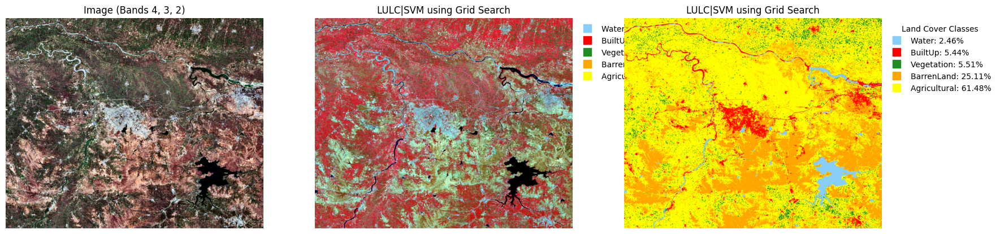

In [ ]:
labels = pre_trained_model_1.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|SVM using Grid Search')

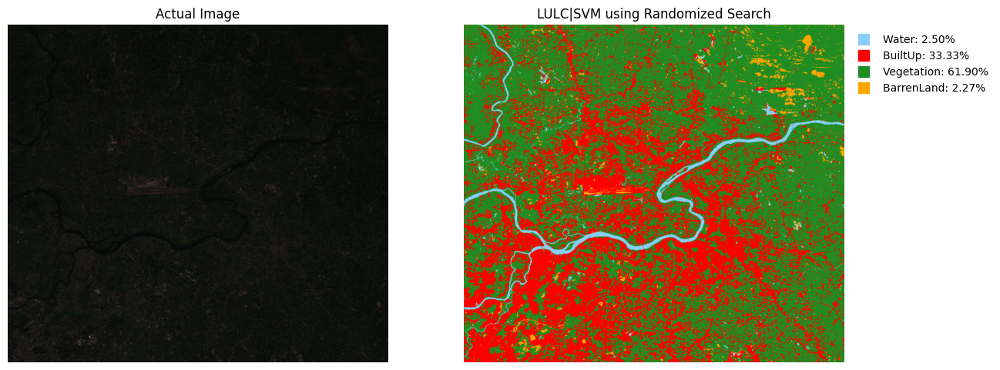

In [ ]:
labels = SVM_RS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|SVM using Randomized Search')

##SVM using Bayes Search

In [ ]:
param_space = {
        'C': Real(1e-6, 1e+6, prior='log-uniform'),
        'gamma': Real(1e-6, 1e+1, prior='log-uniform'),
        'kernel': ['linear', 'rbf', 'poly']
        }

SVM_BS = BayesSearchCV(SVC(),param_space,n_iter=100,refit=True,verbose=0,cv=5,random_state=42)
SVM_BS.fit(x_train,y_train)
print(f"Best Parameters: {SVM_BS.best_params_}")
print(f"Best Estimator: {SVM_BS.best_estimator_}")
getAccuracyAndClassificationReport(SVM_BS,x_val,y_val,x_test,y_test)

Best Parameters: OrderedDict([('C', 45.279426090295644), ('gamma', 10.0), ('kernel', 'rbf')])
Best Estimator: SVC(C=45.279426090295644, gamma=10.0)
Validation Set Evaluation:
Accuracy:  0.9717391304347827
Confusion Matrix:
 [[81  8  0  0  0]
 [ 1 87  0  0  0]
 [ 1  0 98  0  0]
 [ 2  1  0 99  0]
 [ 0  0  0  0 82]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.95      0.91      0.93        89
  BarrenLand       0.91      0.99      0.95        88
     BuiltUp       1.00      0.99      0.99        99
  Vegetation       1.00      0.97      0.99       102
       Water       1.00      1.00      1.00        82

    accuracy                           0.97       460
   macro avg       0.97      0.97      0.97       460
weighted avg       0.97      0.97      0.97       460

F1 Score: 0.9718576829110818
Precision: 0.972960358056266
Recall: 0.9717391304347827
Test Set Evaluation:
Accuracy:  0.9783080260303688
Confusion Matrix:
 [[110   3   0   1

In [ ]:
import pickle

# Save the model after Grid Search tuning
with open('SVM-Bayes-Search.pkl', 'wb') as file:
    pickle.dump(SVM_BS, file)

In [ ]:
with open('SVM-Bayes-Search.pkl', 'rb') as file:
    pre_trained_model_1 = pickle.load(file)

In [ ]:
data3 = pd.read_csv('/content/drive/MyDrive/LULC/Goa-2-FeatureCollection.csv')
# Prepare the new training and validation splits from new data
x_train_new, x_temp_new, y_train_new, y_temp_new = train_test_split(
    data3[['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12']],
    data3['Class'],
    test_size=0.4,
    random_state=42
)
x_val_new, x_test_new, y_val_new, y_test_new = train_test_split(x_temp_new, y_temp_new, test_size=0.5, random_state=42)

# Combine old and new training data
x_combined_train = pd.concat([x_train, x_train_new])
y_combined_train = pd.concat([y_train, y_train_new])

# Fine-tuning the loaded model with new and old combined data
pre_trained_model_1.fit(x_combined_train, y_combined_train)

# Evaluate the fine-tuned model on the new validation and test data
getAccuracyAndClassificationReport(pre_trained_model_1, x_val_new, y_val_new, x_test_new, y_test_new)

# Test accuracy for the newly trained model
getTestAccuracy(pre_trained_model_1, x_test_new, y_test_new)

Validation Set Evaluation:
Accuracy:  0.9556135770234987
Confusion Matrix:
 [[ 39   7   0   0   0]
 [  7  85   1   0   0]
 [  1   1  39   0   0]
 [  0   0   0  89   0]
 [  0   0   0   0 114]]
Classification Report:
               precision    recall  f1-score   support

Agricultural       0.83      0.85      0.84        46
  BarrenLand       0.91      0.91      0.91        93
     BuiltUp       0.97      0.95      0.96        41
  Vegetation       1.00      1.00      1.00        89
       Water       1.00      1.00      1.00       114

    accuracy                           0.96       383
   macro avg       0.94      0.94      0.94       383
weighted avg       0.96      0.96      0.96       383

F1 Score: 0.9557757875790387
Precision: 0.9559927226265208
Recall: 0.9556135770234987
Test Set Evaluation:
Accuracy:  0.9479166666666666
Confusion Matrix:
 [[ 40   4   0   0   0]
 [ 13  86   2   0   0]
 [  1   0  38   0   0]
 [  0   0   0 110   0]
 [  0   0   0   0  90]]
Classification Report:


In [ ]:
getTestAccuracy(SVM_BS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.9104597195474767



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

  BarrenLand       0.00      0.00      0.00         0
     BuiltUp       1.00      0.91      0.95    341542
  Vegetation       0.04      0.96      0.09      1188
       Water       0.34      0.98      0.50       501

    accuracy                           0.91    343231
   macro avg       0.35      0.71      0.39    343231
weighted avg       1.00      0.91      0.95    343231



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


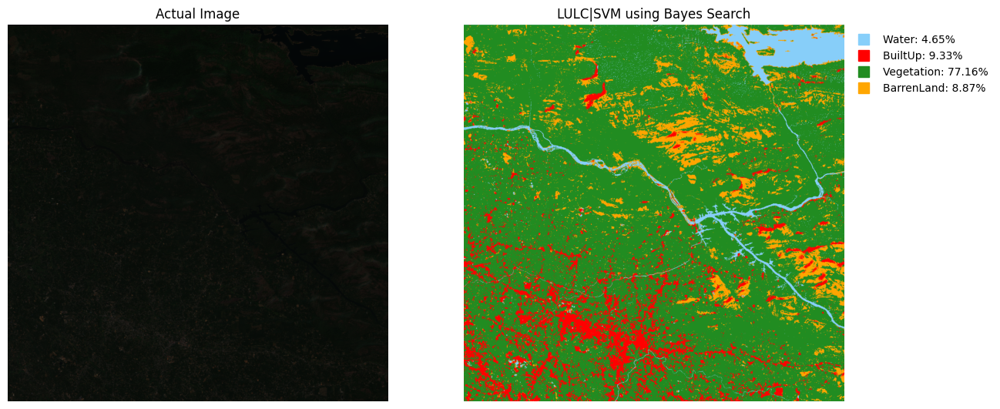

In [ ]:
labels = SVM_BS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|SVM using Bayes Search')

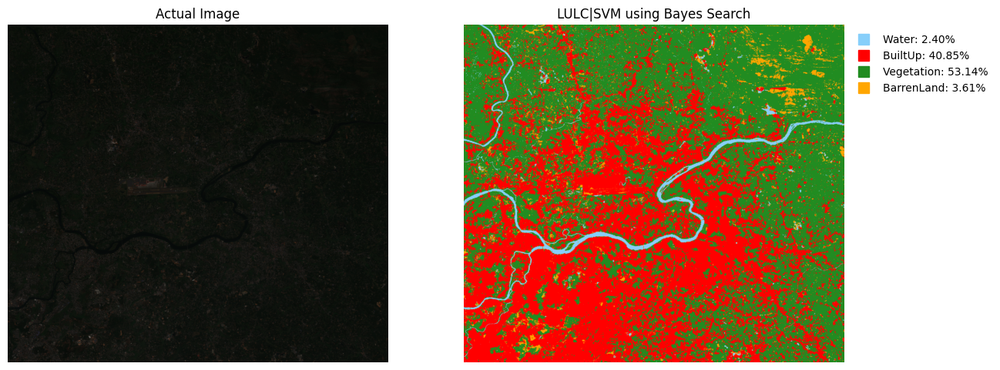

In [ ]:
labels = SVM_BS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|SVM using Bayes Search')

#Random Forest(RF)

##Random Forest Using Grid Search

In [ ]:
param_grid = {
    'n_estimators': [10, 50, 100, 200],          # Number of trees in the forest
    'max_depth': [None, 10, 20, 30, 40],        # Maximum depth of the tree
    'min_samples_split': [2, 5, 10],             # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4],               # Minimum number of samples required to be at a leaf node
    'bootstrap': [True, False]                   # Whether bootstrap samples are used when building trees
    }

RF_GS = GridSearchCV(RandomForestClassifier(),param_grid,refit=True,verbose=0,cv=5)
RF_GS.fit(x_train,y_train)
print(f"Best Parameters: {RF_GS.best_params_}")
print(f"Best Estimator: {RF_GS.best_estimator_}")
getAccuracyAndClassificationReport(RF_GS,x_val,y_val,x_test,y_test)

NameError: name 'GridSearchCV' is not defined

In [ ]:
getTestAccuracy(RF_GS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.8436504861157647



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

  BarrenLand       0.00      0.00      0.00         0
     BuiltUp       1.00      0.84      0.91    341542
  Vegetation       0.02      0.96      0.05      1188
       Water       0.19      0.99      0.32       501

    accuracy                           0.84    343231
   macro avg       0.30      0.70      0.32    343231
weighted avg       1.00      0.84      0.91    343231



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


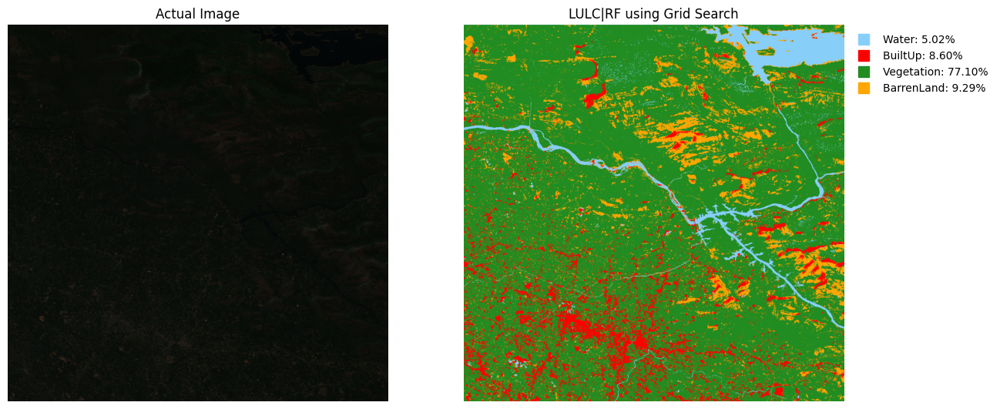

In [ ]:
labels = RF_GS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|RF using Grid Search')

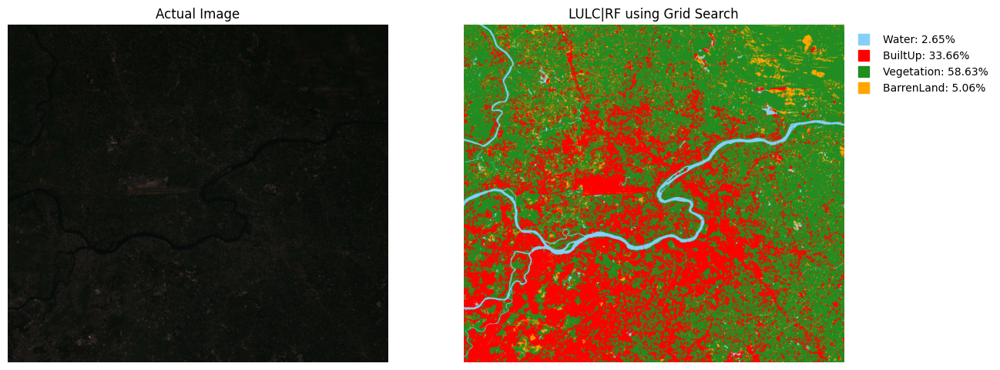

In [ ]:
labels = RF_GS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|RF using Grid Search')

##Random Forest using Randomized Search

In [ ]:
param_dist = {
    'n_estimators': randint(10, 200),             # Number of trees in the forest
    'max_depth': [None] + list(range(10, 51)),   # Maximum depth of the tree
    'min_samples_split': randint(2, 20),          # Minimum number of samples required to split an internal node
    'min_samples_leaf': randint(1, 20),           # Minimum number of samples required to be at a leaf node
    'bootstrap': [True, False]                    # Whether bootstrap samples are used when building trees
    }

RF_RS = RandomizedSearchCV(RandomForestClassifier(),param_distributions=param_dist,n_iter=50,refit=True,verbose=0,cv=5,random_state=42)
RF_RS.fit(x_train,y_train)
print(f"Best Parameters: {RF_RS.best_params_}")
print(f"Best Estimator: {RF_RS.best_estimator_}")
getAccuracyAndClassificationReport(RF_RS,x_val,y_val,x_test,y_test)

Best Parameters: {'bootstrap': True, 'max_depth': 43, 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 50}
Best Estimator: RandomForestClassifier(max_depth=43, min_samples_split=6, n_estimators=50)
Validation Set Evaluation:
Accuracy:  0.9719222462203023
Confusion Matrix:
 [[ 72   6   0   0]
 [  1 114   2   0]
 [  1   2 115   1]
 [  0   0   0 149]]
Classification Report:
               precision    recall  f1-score   support

  BarrenLand       0.97      0.92      0.95        78
     BuiltUp       0.93      0.97      0.95       117
  Vegetation       0.98      0.97      0.97       119
       Water       0.99      1.00      1.00       149

    accuracy                           0.97       463
   macro avg       0.97      0.97      0.97       463
weighted avg       0.97      0.97      0.97       463

F1 Score: 0.9718921125606925
Precision: 0.9723374500579471
Recall: 0.9719222462203023
Test Set Evaluation:
Accuracy:  0.9740820734341252
Confusion Matrix:
 [[ 77   3   0   0]
 

In [ ]:
getTestAccuracy(RF_RS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.8165725123896151



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

  BarrenLand       0.00      0.00      0.00         0
     BuiltUp       1.00      0.82      0.90    341542
  Vegetation       0.02      0.96      0.04      1188
       Water       0.19      0.99      0.32       501

    accuracy                           0.82    343231
   macro avg       0.30      0.69      0.31    343231
weighted avg       1.00      0.82      0.89    343231



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


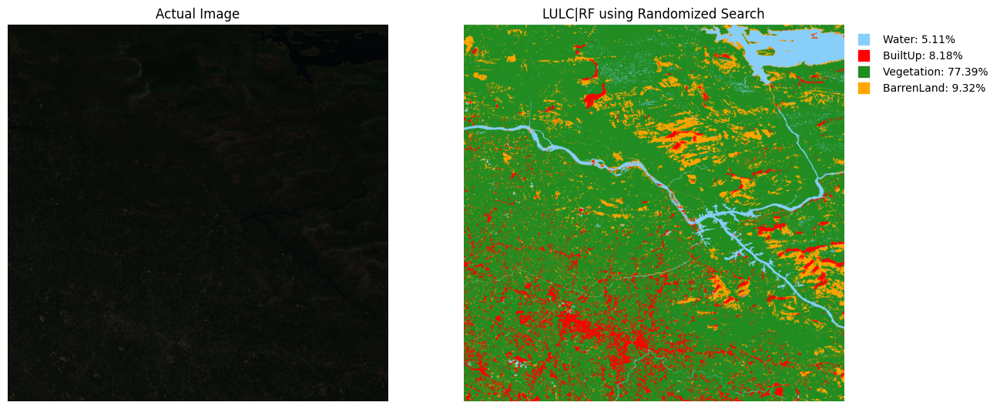

In [ ]:
labels = RF_RS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|RF using Randomized Search')

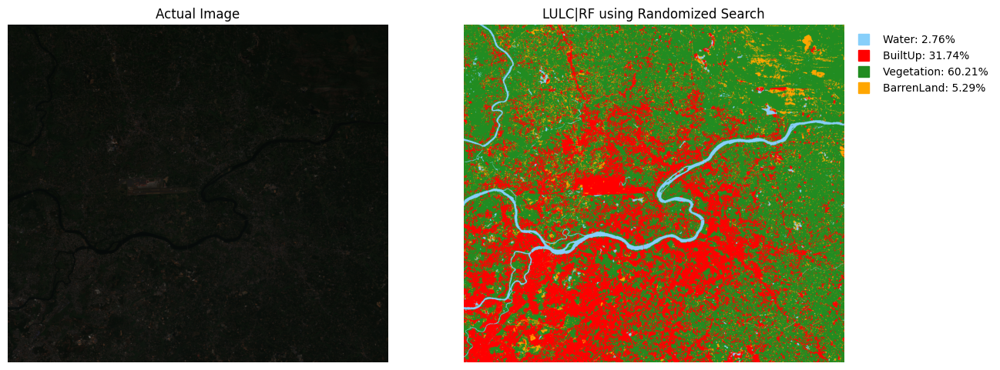

In [ ]:
labels = RF_RS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|RF using Randomized Search')

##Random Forest using Bayes Search

In [ ]:
param_space = {
    'n_estimators': Integer(10, 200),              # Number of trees in the forest
    'max_depth': Categorical([None] + list(range(10, 51))),  # Maximum depth of the tree
    'min_samples_split': Integer(2, 20),           # Minimum number of samples required to split an internal node
    'min_samples_leaf': Integer(1, 20),            # Minimum number of samples required to be at a leaf node
    'bootstrap': Categorical([True, False])       # Whether bootstrap samples are used when building trees
    }

RF_BS = BayesSearchCV(estimator=RandomForestClassifier(),search_spaces=param_space,n_iter=50,cv=5,n_jobs=-1,verbose=0)
RF_BS.fit(x_train,y_train)
print(f"Best Parameters: {RF_BS.best_params_}")
print(f"Best Estimator: {RF_BS.best_estimator_}")
getAccuracyAndClassificationReport(RF_BS,x_val,y_val,x_test,y_test)

Best Parameters: OrderedDict([('bootstrap', False), ('max_depth', 11), ('min_samples_leaf', 1), ('min_samples_split', 2), ('n_estimators', 200)])
Best Estimator: RandomForestClassifier(bootstrap=False, max_depth=11, n_estimators=200)
Validation Set Evaluation:
Accuracy:  0.9719222462203023
Confusion Matrix:
 [[ 72   6   0   0]
 [  1 114   2   0]
 [  1   2 115   1]
 [  0   0   0 149]]
Classification Report:
               precision    recall  f1-score   support

  BarrenLand       0.97      0.92      0.95        78
     BuiltUp       0.93      0.97      0.95       117
  Vegetation       0.98      0.97      0.97       119
       Water       0.99      1.00      1.00       149

    accuracy                           0.97       463
   macro avg       0.97      0.97      0.97       463
weighted avg       0.97      0.97      0.97       463

F1 Score: 0.9718921125606925
Precision: 0.9723374500579471
Recall: 0.9719222462203023
Test Set Evaluation:
Accuracy:  0.9719222462203023
Confusion Matrix:

In [ ]:
getTestAccuracy(RF_BS,data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']],data2['Class'])


Accuracy: 0.851199338055129



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

  BarrenLand       0.00      0.00      0.00         0
     BuiltUp       1.00      0.85      0.92    341542
  Vegetation       0.03      0.96      0.05      1188
       Water       0.18      0.99      0.30       501

    accuracy                           0.85    343231
   macro avg       0.30      0.70      0.32    343231
weighted avg       1.00      0.85      0.92    343231



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


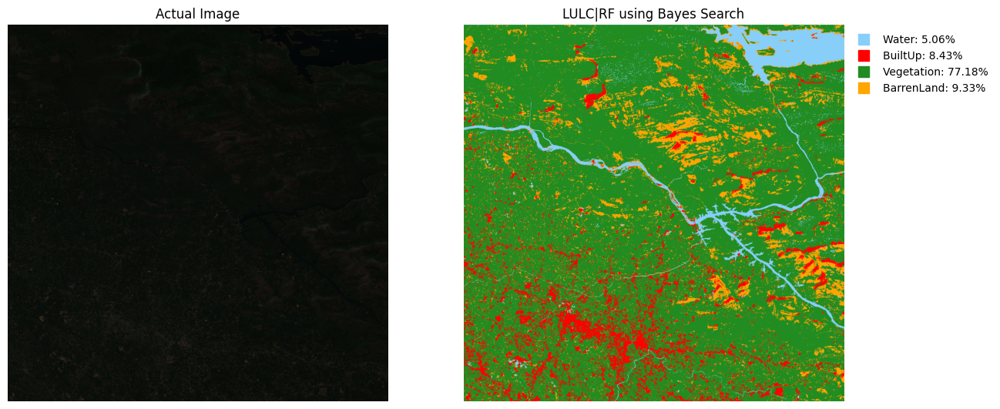

In [ ]:
labels = RF_BS.predict(image1_dataset)
PlotClassifiedMap(image1,labels,image1_shape,'LULC|RF using Bayes Search')

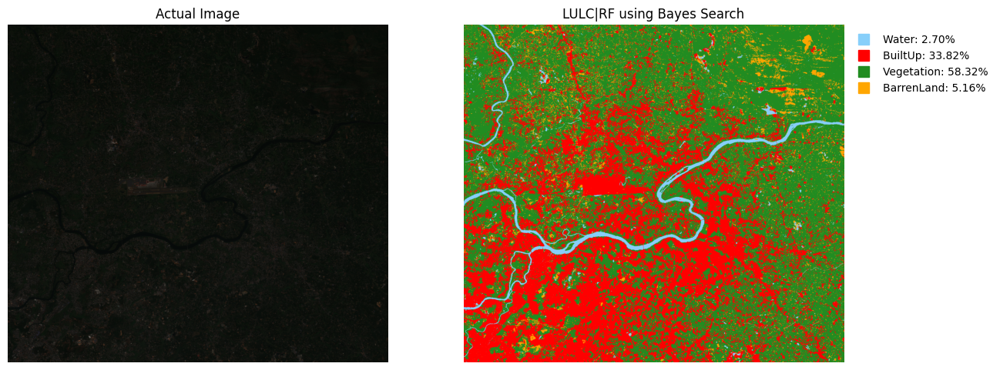

In [ ]:
labels = RF_BS.predict(image2_dataset)
PlotClassifiedMap(image2,labels,image2_shape,'LULC|RF using Bayes Search')

#Artifical Neural Network

Importing neccessary python modules for ANN

In [ ]:
from sklearn.preprocessing import StandardScaler,LabelEncoder
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import to_categorical

In [ ]:
scaler = StandardScaler()
label_encoder = LabelEncoder()

Data Preprocessing

In [ ]:
ann_x_train = scaler.fit_transform(x_train)
ann_x_test = scaler.transform(x_test)
ann_x_val = scaler.transform(x_val)

ann_y_train = to_categorical(label_encoder.fit_transform(y_train))
ann_y_test = to_categorical(label_encoder.transform(y_test))
ann_y_val = to_categorical(label_encoder.transform(y_val))

Defining the ANN layers

In [ ]:
model = Sequential()

# Add the input layer and the first hidden layer
model.add(Dense(units=64, activation='relu', input_dim=image1.count))
# Add more hidden layers (optional)
model.add(Dense(units=64, activation='relu'))
model.add(Dense(units=32, activation='relu'))

# Add the output layer
model.add(Dense(units=4, activation='softmax'))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Training, validating and testing the model

In [ ]:
model.fit(ann_x_train, ann_y_train, batch_size=32, epochs=50, validation_data=(ann_x_val, ann_y_val))

loss,accuracy = model.evaluate(ann_x_test,ann_y_test)
print(f'Test Loss: {loss}')
print(f'Test Accuracy: {accuracy}')


Epoch 1/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 12s 108ms/step - accuracy: 0.6878 - loss: 1.0411 - val_accuracy: 0.9438 - val_loss: 0.3039
Epoch 2/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9446 - loss: 0.2778 - val_accuracy: 0.9633 - val_loss: 0.1456
Epoch 3/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9523 - loss: 0.1827 - val_accuracy: 0.9654 - val_loss: 0.1234
Epoch 4/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9684 - loss: 0.1106 - val_accuracy: 0.9654 - val_loss: 0.1208
Epoch 5/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9679 - loss: 0.1126 - val_accuracy: 0.9633 - val_loss: 0.1244
Epoch 6/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9747 - loss: 0.1045 - val_accuracy: 0.9633 - val_loss: 0.1084
Epoch 7/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9735 - loss: 0.0992 - val_accuracy: 0.9633 - val_loss: 0.1126
Epoch 8/50
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9659 - loss: 0.1061 - val_accuracy: 0.9633 - val_lo

Testing on another dataset 'data2'

In [ ]:
x = scaler.transform(data2[['B1','B2','B3','B4','B5','B6','B7','B8','B8A','B9','B11','B12']])
y = to_categorical(label_encoder.transform(data2['Class']))

loss,accuracy = model.evaluate(x,y)
print(f'Test Loss: {loss}')
print(f'Test Accuracy: {accuracy}')

10726/10726 ━━━━━━━━━━━━━━━━━━━━ 19s 2ms/step - accuracy: 0.9135 - loss: 0.3288
Test Loss: 0.34667351841926575
Test Accuracy: 0.9120388031005859


In [ ]:
x_new1 = scaler.transform(image1_dataset)
y_pred1 = model.predict(x_new1)

206480/206480 ━━━━━━━━━━━━━━━━━━━━ 288s 1ms/step


In [ ]:
predicted_classes = np.argmax(y_pred1, axis=1)
predicted_labels = label_encoder.inverse_transform(predicted_classes)
predicted_labels

array(['Water', 'Water', 'Water', ..., 'Vegetation', 'Water', 'Water'],
      dtype=object)

/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


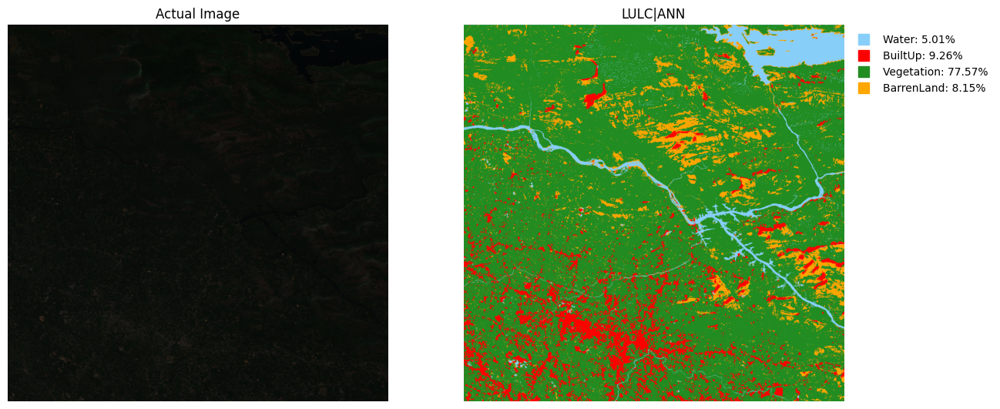

In [ ]:
PlotClassifiedMap(image1,predicted_labels,image1_shape,'LULC|ANN')

In [ ]:
x_new2 = scaler.transform(image2_dataset)
y_pred2 = model.predict(x_new2)

203702/203702 ━━━━━━━━━━━━━━━━━━━━ 278s 1ms/step


In [ ]:
predicted_classes = np.argmax(y_pred2, axis=1)
predicted_labels = label_encoder.inverse_transform(predicted_classes)
predicted_labels

array(['Vegetation', 'Vegetation', 'Vegetation', ..., 'Vegetation',
       'Vegetation', 'Vegetation'], dtype=object)

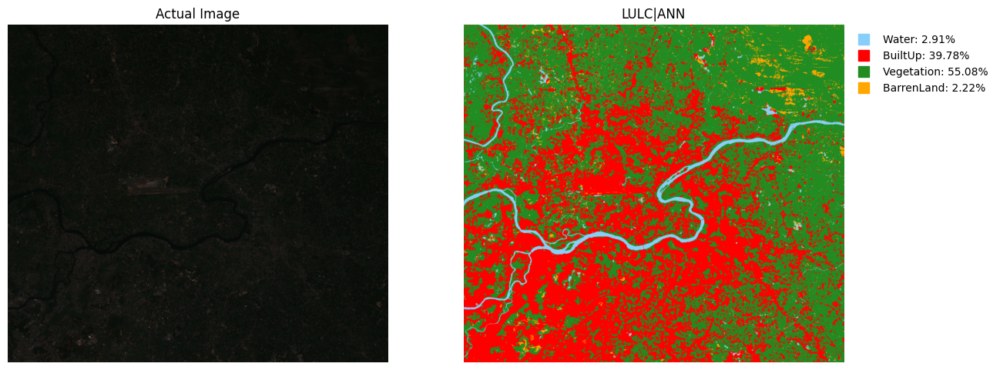

In [ ]:
PlotClassifiedMap(image2,predicted_labels,image2_shape,'LULC|ANN')

In [ ]:
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(ann_y_test, axis=1)

# Calculate metrics
print("Classification Report:")
print(classification_report(y_test_classes, y_pred_classes))

f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')
precision = precision_score(y_test_classes, y_pred_classes, average='weighted')
recall = recall_score(y_test_classes, y_pred_classes, average='weighted')

print(f"F1 Score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 100ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.18      1.00      0.30        80
           1       0.00      0.00      0.00       119
           2       1.00      0.12      0.22       139
           3       0.00      0.00      0.00       125

    accuracy                           0.21       463
   macro avg       0.29      0.28      0.13       463
weighted avg       0.33      0.21      0.12       463

F1 Score: 0.11799022150178849
Precision: 0.33120901897354943
Recall: 0.20950323974082075


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classif

In [ ]:
y_pred = model.predict(x_val)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(ann_y_val, axis=1)

# Calculate metrics
print("Classification Report:")
print(classification_report(y_test_classes, y_pred_classes))

f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')
precision = precision_score(y_test_classes, y_pred_classes, average='weighted')
recall = recall_score(y_test_classes, y_pred_classes, average='weighted')

print(f"F1 Score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")

15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Classification Report:
              precision    recall  f1-score   support

           0       0.17      1.00      0.30        78
           1       0.00      0.00      0.00       117
           2       1.00      0.13      0.24       119
           3       0.00      0.00      0.00       149

    accuracy                           0.20       463
   macro avg       0.29      0.28      0.13       463
weighted avg       0.29      0.20      0.11       463

F1 Score: 0.11098175003142607
Precision: 0.2864162813283662
Recall: 0.20302375809935205


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classif